In [1]:
!pip install livelossplot

In [0]:
import numpy as np
import pandas as pd

from matplotlib import pyplot as plt
from matplotlib import collections as mc

from geopy.distance import distance

from livelossplot import PlotLosses

### Data preporation

In [3]:
df = pd.read_csv('cities.csv')[['Город', 'Регион', 'Население', 'Широта', 'Долгота']]
df = df[df['Город'] != 'Иннополис']
df

,Город,Регион,Население,Широта,Долгота
0,Адыгейск,Адыгея,12689,44.878372,39.190172
1,Майкоп,Адыгея,144055,44.609827,40.100653
2,Горно-Алтайск,Алтай,62861,51.958268,85.960296
3,Алейск,Алтайский,28528,52.492091,82.779415
4,Барнаул,Алтайский,635585,53.348115,83.779836
...,...,...,...,...,...
1107,Ростов,Ярославская,31791,57.205018,39.437836
1108,Рыбинск,Ярославская,200771,58.048380,38.858338
1109,Тутаев,Ярославская,41001,57.867424,39.536823
1110,Углич,Ярославская,34505,57.522387,38.301979


In [4]:
df = df.astype({'Население': 'int32'})
df = df.sort_values(by = ['Население'], ascending=False)[:30]
df

,Город,Регион,Население,Широта,Долгота
506,NaN,Москва,11514330,55.753879,37.620373
782,NaN,Санкт-Петербург,4848742,59.939125,30.315822
643,Новосибирск,Новосибирская,1498921,55.028102,82.921057
828,Екатеринбург,Свердловская,1377738,56.838633,60.605489
615,Нижний Новгород,Нижегородская,1250615,56.324209,44.005395
924,Казань,Татарстан,1216965,55.794388,49.111531
778,Самара,Самарская,1164900,53.195166,50.106769
652,Омск,Омская,1154000,54.984814,73.367464
1060,Челябинск,Челябинская,1130273,55.160366,61.400786
753,Ростов-на-Дону,Ростовская,1091544,47.222436,39.718787


In [5]:
df['Город'] = np.where(df['Город'] != df['Город'], df['Регион'], df['Город'])
df = df.drop(columns = ['Регион', 'Население'])
df

,Город,Широта,Долгота
506,Москва,55.753879,37.620373
782,Санкт-Петербург,59.939125,30.315822
643,Новосибирск,55.028102,82.921057
828,Екатеринбург,56.838633,60.605489
615,Нижний Новгород,56.324209,44.005395
924,Казань,55.794388,49.111531
778,Самара,53.195166,50.106769
652,Омск,54.984814,73.367464
1060,Челябинск,55.160366,61.400786
753,Ростов-на-Дону,47.222436,39.718787


In [6]:
cities = df.values
cities

array([['Москва', 55.7538789, 37.6203735],
       ['Санкт-Петербург', 59.939125, 30.315822499999996],
       ['Новосибирск', 55.02810160000001, 82.92105749999999],
       ['Екатеринбург', 56.8386326, 60.6054887],
       ['Нижний Новгород', 56.3242093, 44.0053948],
       ['Казань', 55.794387699999994, 49.1115312],
       ['Самара', 53.195165700000004, 50.1067691],
       ['Омск', 54.9848136, 73.3674638],
       ['Челябинск', 55.160365899999995, 61.4007858],
       ['Ростов-на-Дону', 47.2224364, 39.7187866],
       ['Уфа', 54.734853, 55.9578647],
       ['Волгоград', 48.7072005, 44.5170207],
       ['Пермь', 58.0103211, 56.23417779999999],
       ['Красноярск', 56.009466, 92.85241620000001],
       ['Воронеж', 51.6592378, 39.1968284],
       ['Саратов', 51.530376000000004, 45.953025700000005],
       ['Краснодар', 45.040234999999996, 38.976080100000004],
       ['Тольятти', 53.520643799999995, 49.389461],
       ['Барнаул', 53.3481145, 83.7798362],
       ['Ижевск', 56.8527444, 53.21139

### Visualization

In [0]:
liveplot = PlotLosses(skip_first=0)

### Simulated Annealing as an optimization method

In [0]:
def get_new_path(prev_path: list) -> list:
    new_path = prev_path.copy()
    a, b = np.random.randint(0, len(prev_path), 2)
    tmp = new_path[a].copy()
    new_path[a] = new_path[b].copy()
    new_path[b] = tmp
    return new_path

In [0]:
def path_distance(path: list) -> float:
    last2first_dist = distance((path[-1][1], path[-1][2]), (path[0][1], path[0][2])).km
    return last2first_dist + sum([distance((lat1, long1), (lat2, long2)).km
                                for (_, lat1, long1), (_, lat2, long2)
                                in zip(path, path[1:])])

In [0]:
def find_optimal_path(salesman_path, T = 1000, cooled_T = 20, annealing_rate = 0.95):
    path_for_animation = []
    
    while (T > cooled_T):
        current_salesman_path = salesman_path.copy()
        current_loss = path_distance(current_salesman_path)

        new_salesman_path = get_new_path(salesman_path)
        new_loss = path_distance(new_salesman_path)
        
        if (np.random.uniform() <= np.exp((current_loss - new_loss) / T)):
          salesman_path = new_salesman_path
        else:
          salesman_path = current_salesman_path
          new_loss = current_loss
            
        T *= annealing_rate

        liveplot.update({
            'loss': new_loss,
        })
        liveplot.draw()

        path_for_animation.append(new_salesman_path.copy())

    return cities, path_for_animation

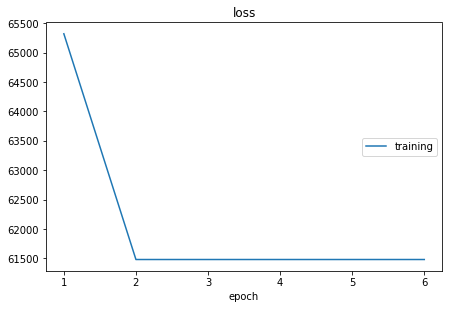

loss:
training   (min: 61481.689, max: 65318.258, cur: 61481.689)
CPU times: user 1.92 s, sys: 632 ms, total: 2.55 s
Wall time: 1.87 s


In [11]:
%%time
annealing_rate = 0.5
optimal_cities, path_for_animation = find_optimal_path(cities, annealing_rate=annealing_rate)

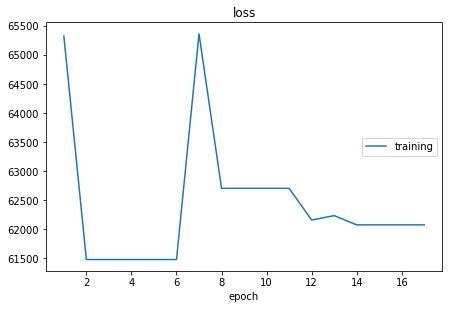

loss:
training   (min: 61481.689, max: 65359.137, cur: 62076.993)
CPU times: user 3.67 s, sys: 1.14 s, total: 4.8 s
Wall time: 3.54 s


In [12]:
%%time
annealing_rate = 0.7
optimal_cities, path_for_animation = find_optimal_path(cities, annealing_rate=annealing_rate)

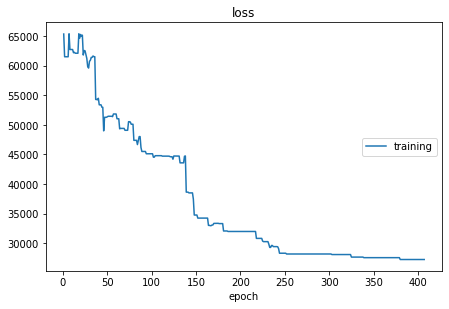

loss:
training   (min: 27266.769, max: 65359.137, cur: 27266.769)
CPU times: user 2min 7s, sys: 40 s, total: 2min 47s
Wall time: 2min 2s


In [13]:
%%time
annealing_rate = 0.99
optimal_cities, path_for_animation = find_optimal_path(cities, annealing_rate=annealing_rate)

In [15]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation, rc
from IPython.display import HTML

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(figsize=(20, 10))
plt.scatter([x[1] for x in cities], [x[2] for x in cities])
for name, lat, lng in cities:
  plt.annotate(name, (lat, lng))
plt.close()

line, = ax.plot([], [], lw=2)

for name, lat, lng in cities:
    plt.annotate(name, (lat, lng))

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return (line,)

# animation function. This is called sequentially  
def animate(i):
    x = [x[1] for x in path_for_animation[i]] + [path_for_animation[i][0][1]]
    y = [x[2] for x in path_for_animation[i]] + [path_for_animation[i][0][2]]
    line.set_data(x, y)
    return (line,)
  

anim = animation.FuncAnimation(fig, animate, init_func=init,
                             frames=100, interval=100, blit=True)

# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
anim